MASOURIS ATHANASIOS <br>
03115189 NTUA ECE

<h2> 3<sup>rd</sup> Lab Exercise: Genetic Algorithms</h2>

In this exercise we are going to learn how to use genetic algorithms and how to choose their parameters. In addition, we are going to implement two genetic algorithms. The first one will be about solving the ONEMAX problem. The second one will be used for community detection in graphs. We will implement the [GA-Net](https://link.springer.com/chapter/10.1007/978-3-540-87700-4_107). Then we are going to compare its performance with the performance of the algorithms we used in Lab2.

In [0]:
%matplotlib inline

import matplotlib
import networkx as nx
import matplotlib.pyplot as plt
import numpy as np
import scipy as sp
import random
import joblib
from matplotlib import gridspec

In [0]:
plt.style.use("seaborn")
plt.rcParams['figure.figsize'] = 20 , 10
plt.rcParams['figure.facecolor'] = 'white'

# Part A: ONEMAX problem

The ONEMAX is a toy problem designed for introduction to Genetic Algorithms. It gives a basic intuition of how we construct a genetic algorithm and the ways with which we can optimize its performance.

**ONEMAX**: Find the binary sequence $(x_1, x_2, ..., x_n)$ that maximizes the sum $(x_1, x_2, ..., x_n)$. 

Analyze the effect of the population size, the crossover probability and the mutation probability in the performance of the algorithm's solution (how close it is to the optimal solution). More specifically, use the following parameters:

| Variable              |           Range           |
|-----------------------|:-------------------------:|
| Population size       |   [10,100] with step 10   |
| Crossover probability |  [0.3,0.9] with step 0.1  |
| Mutation probability  | [0.01,0.2] with step 0.01 |

**Note:** Elitism is optional



In [0]:
n=20

## Genetic Algorithm Implementation

In [0]:
def create_population(n,m):
  # Create the initial population
  population = []
  for j in range(m):
    population.append(''.join(random.choice('01') for i in range(n)))
  return population

def find_fitness(population):
  # Calculate fitness of chromosomes
  fit = []
  for chrom in population:
    s = 0
    for gen in chrom:
      s = s + int(gen)
    fit.append(s)
  return fit

def proportional_selection(population, fit):
  # Select chromosomes to pass to next population proportionally to their fitness
  p = []
  s = sum(fit)
  for fit_score in fit:
    p.append(fit_score/s)
  
  new_pop = []
  for i in range(len(population)):
    x = random.uniform(0,1)
    k = 0
    while k < len(population)-1 and x > sum(p[0:k]):
      k=k+1
    
    new_pop.append(population[k])
  
  return new_pop

def crossover(pc, population):
  # Apply crossover to population
  for i in range(0,len(population)-1, 2):
    if random.uniform(0,1) < pc:
      pos = random.randint(0,len(population[0]))
      population[i], population[i+1]  = population[i][:pos] + population[i+1][pos:] , population[i+1][:pos] + population[i][pos:]
  
  return population

def mutation(pm,population):
  # Apply mutation to population
  for i in range(len(population)):
    chrom = list(population[i])
    for j in range(len(chrom)):
      if random.uniform(0,1) < pm:
        chrom[j] = str(abs(int(chrom[j])-1))
    population[i] = ''.join(chrom)
  return population

def print_gen_info(population,fit,t):
  best = np.argmax(fit)
  print('Generation %d max fitness: %f at %s' %(t,fit[best],population[best]))
  for i in range(len(population)):
    print("#%d    %s fitness: %f" %(i,population[i],fit[i]))
  print('Average fitness: %f\n' %np.mean(fit))

def genetic_algorithm(n,m,pc,pm,verb):
  # Main genetic algorithm
  gens = []
  t=0

  population = create_population(n,m)
  fit = find_fitness(population)
  if verb: print_gen_info(population,fit,t)
  best = np.argmax(fit)
  cnt = 1
  old_best = fit[best]
  gens.append((population[best], fit[best]))

  while t < 80 and cnt<=5:  
    t=t+1
    sel_pop = proportional_selection(population, fit)
    cross_pop = crossover(pc, sel_pop)
    population = mutation(pm, cross_pop)

    fit = find_fitness(population)

    if verb: print_gen_info(population,fit,t)
    best = np.argmax(fit)

    if fit[best] == old_best: cnt=cnt+1
    else: 
      cnt=1
      old_best = fit[best]

    gens.append((population[best], fit[best]))

  best_chrom = sorted(gens,key=lambda x: x[1], reverse=True)[0]

  return gens, best_chrom

## Using the Genetic Algorithm

In [0]:
#Ranges for the parameters
m_values = list(range(10,101,10))
pc_values = list(np.arange(0.3,0.9,0.1))
pm_values = list(np.arange(0.01,0.2,0.01))

In [0]:
#Using the GA
gens = np.zeros((len(m_values),len(pc_values),len(pm_values)))
for i in range(len(m_values)):
  for j in range(len(pc_values)):
    for k in range(len(pm_values)):
      _, best_chrom = genetic_algorithm(n, m_values[i], pc_values[j], pm_values[k], False)
      gens[i,j,k] = best_chrom[1]

## Saving/Loading the results

In [0]:
#Saving the results
joblib.dump(gens,'gens.pkl')

['gens.pkl']

In [0]:
#Loading the results
gens = joblib.load('gens.pkl')

In [0]:
print("Best value: %d" %int(np.max(gens)))

Best value: 20


## The evolution of the GA's solutions

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


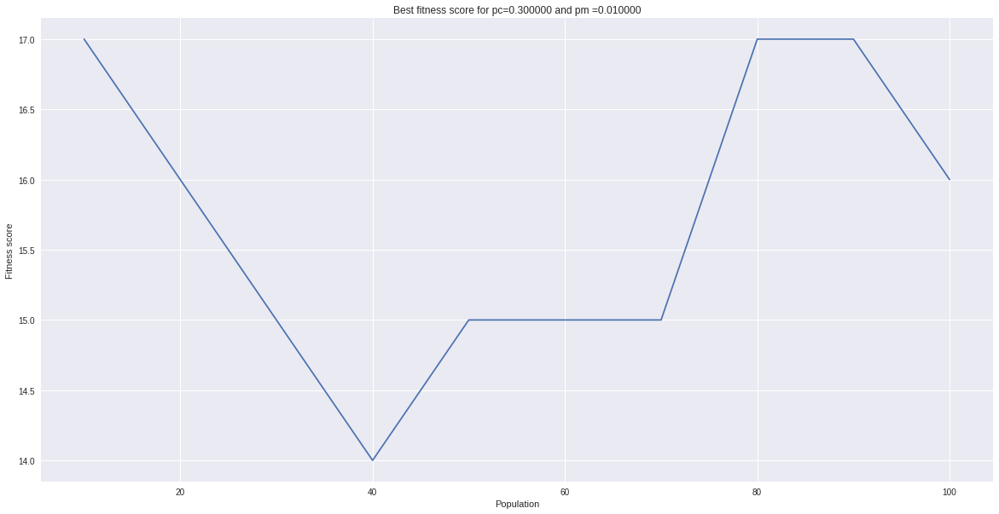

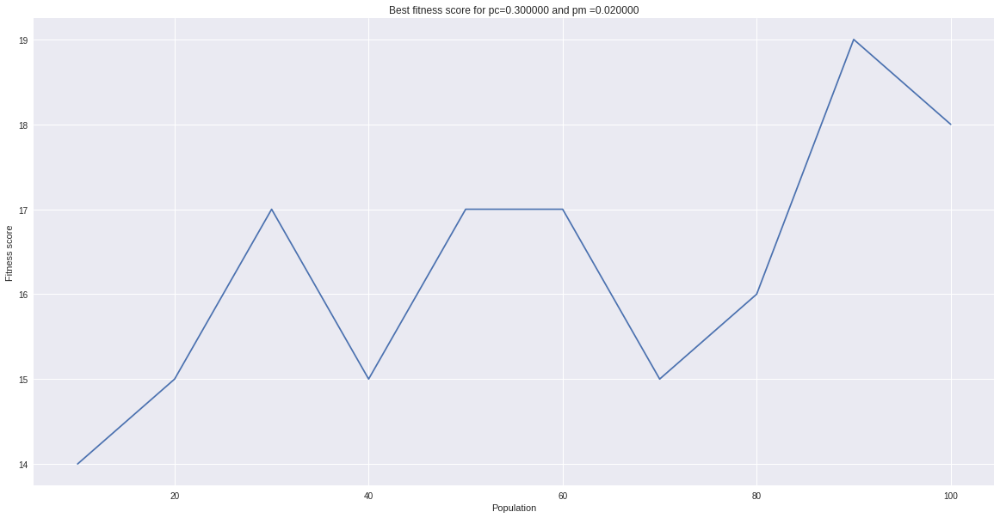

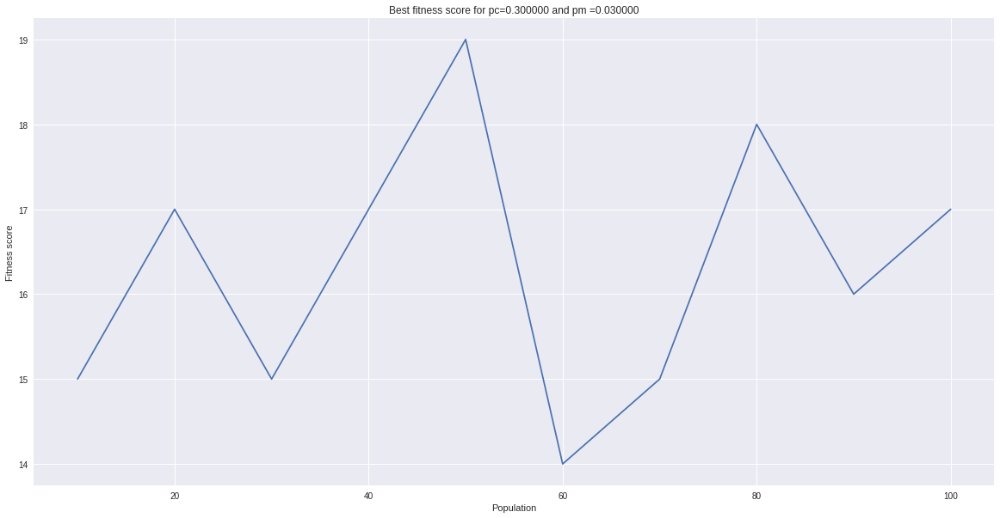

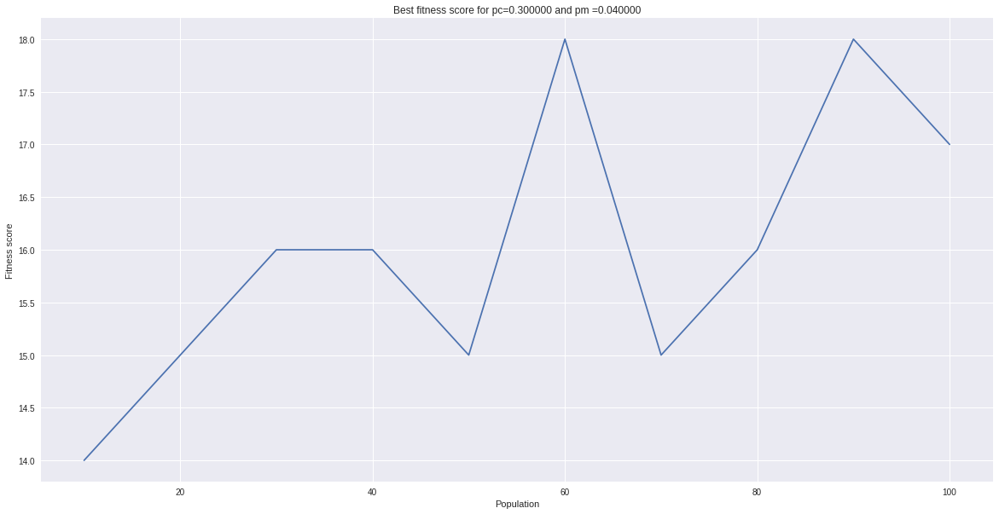

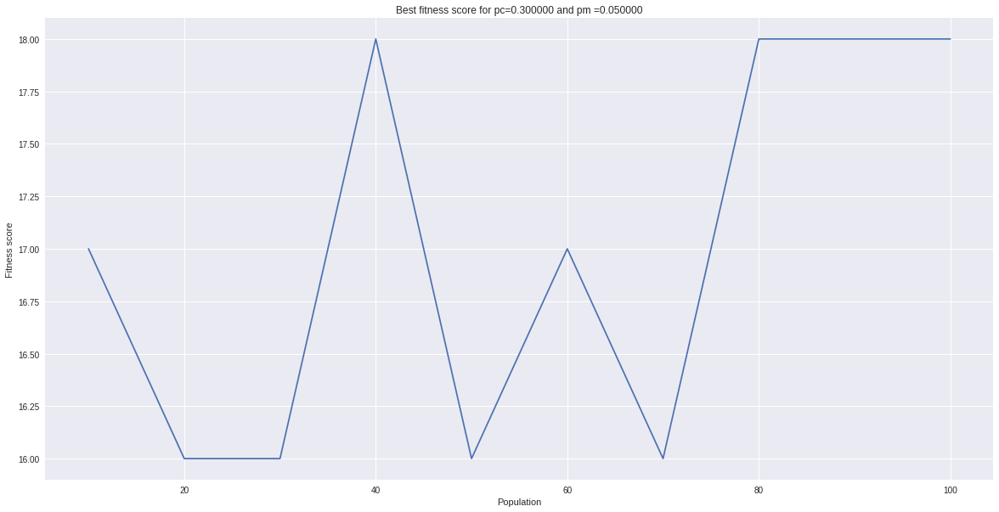

...

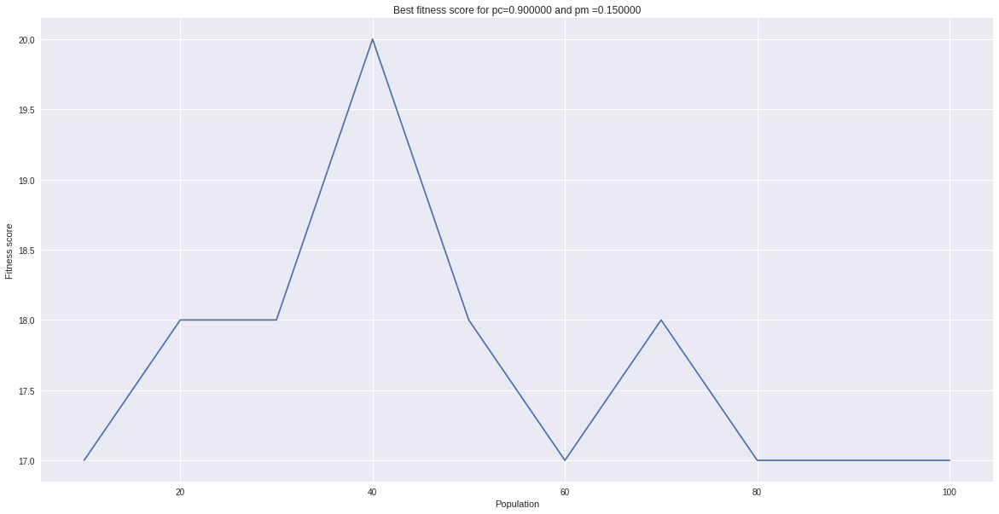

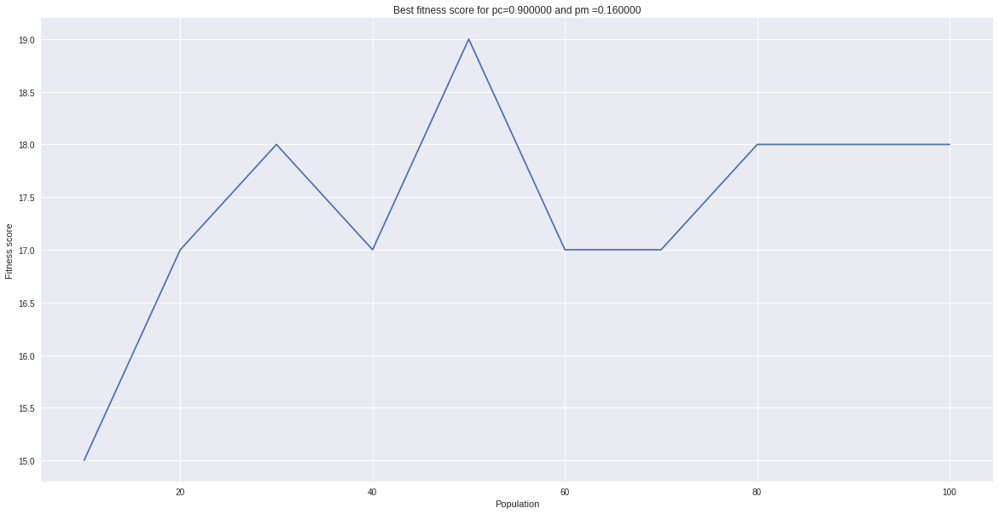

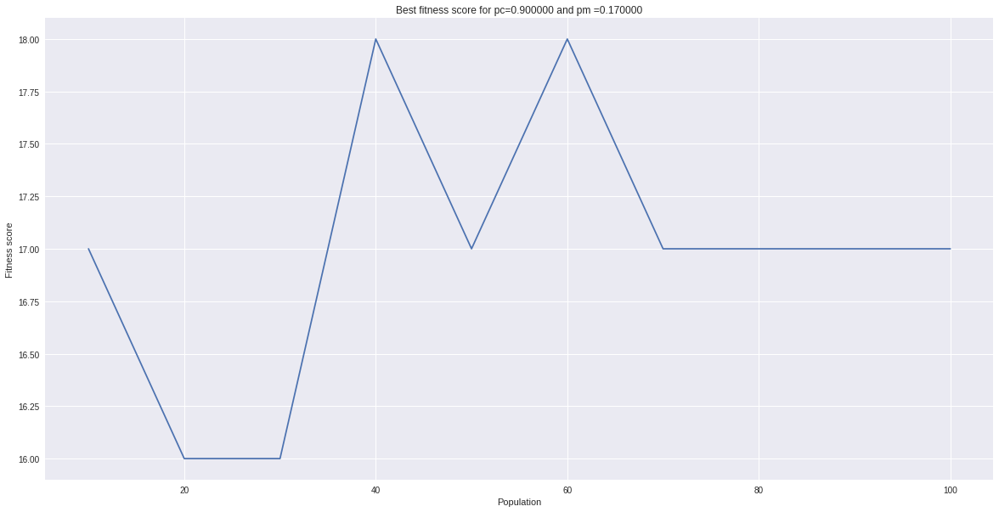

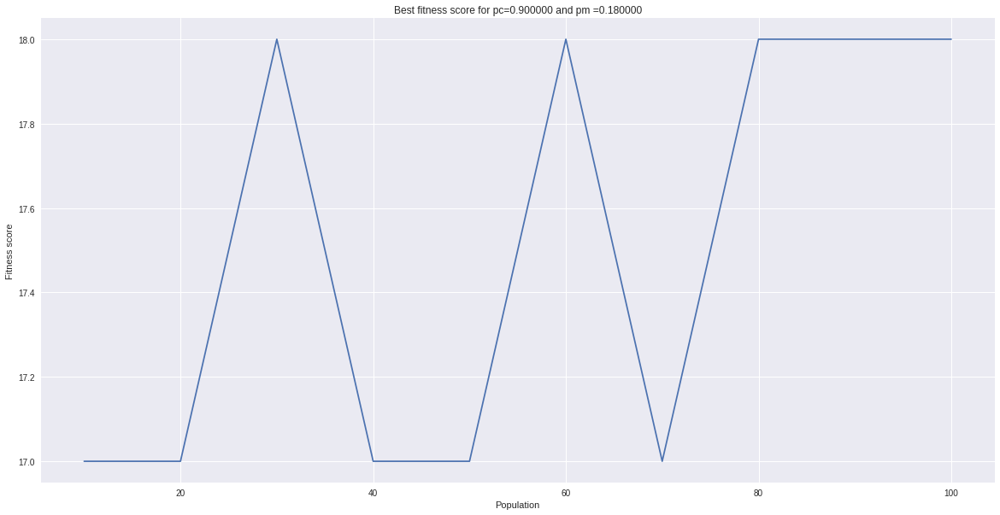

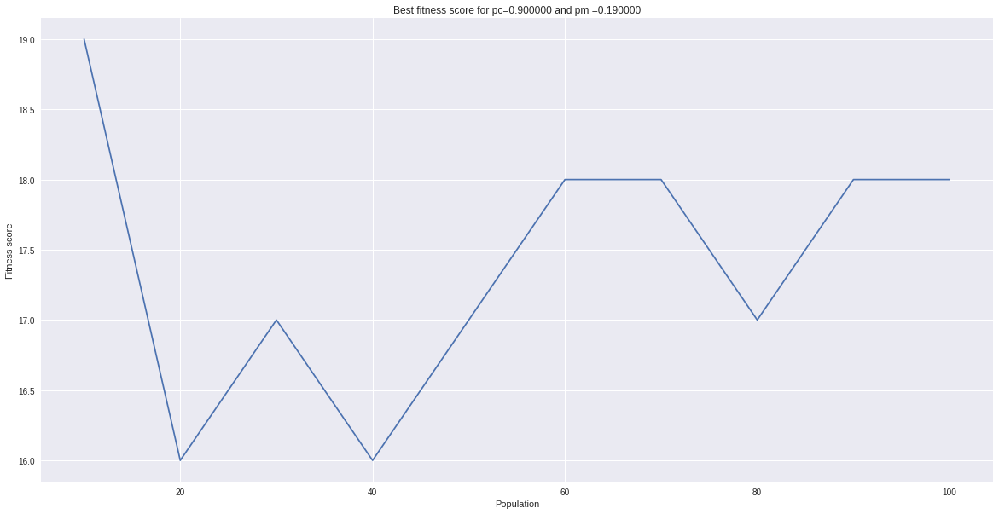

In [0]:
for j in range(len(pc_values)):
  for k in range(len(pm_values)):
    plt.figure()
    plt.title("Best fitness score for pc=%f and pm =%f" %(pc_values[j],pm_values[k]))
    plt.ylabel("Fitness score")
    plt.xlabel("Population")
    
    plt.plot(m_values,gens[:,j,k])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


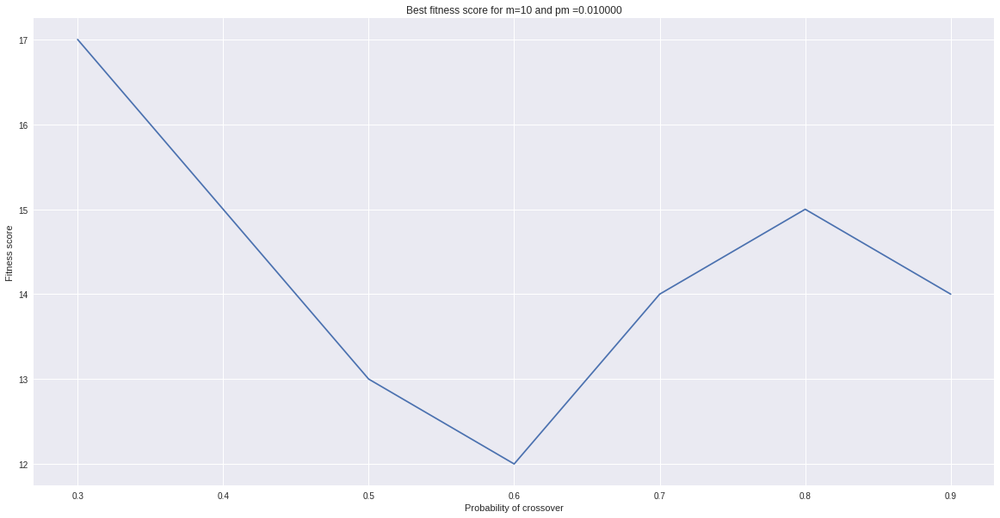

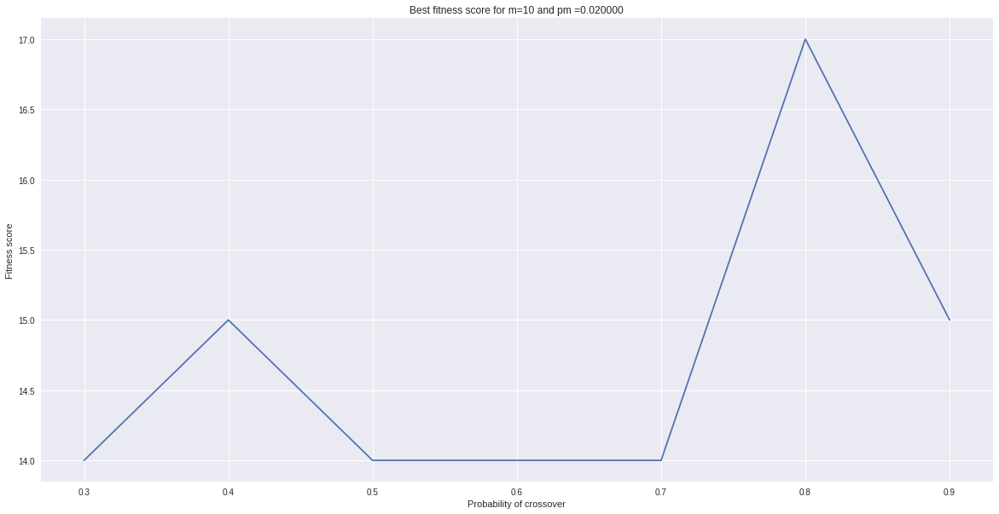

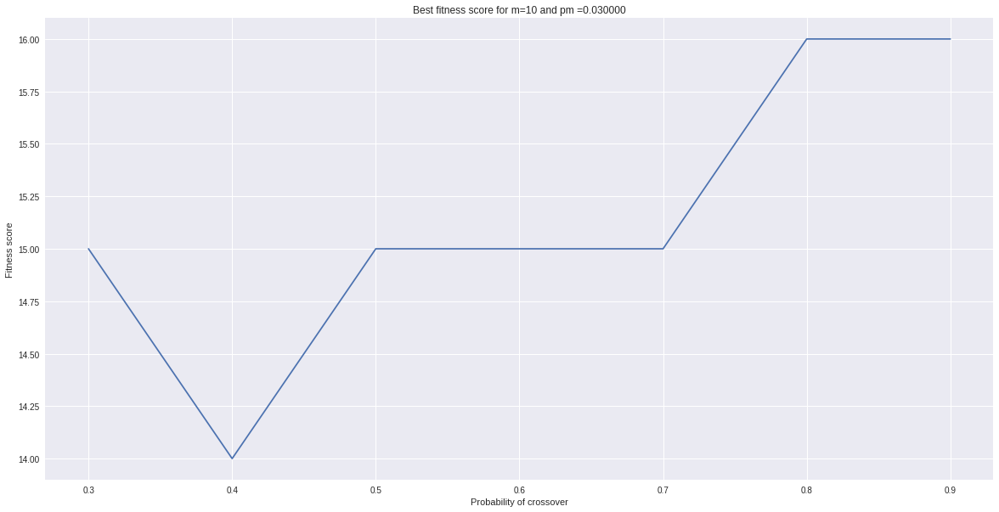

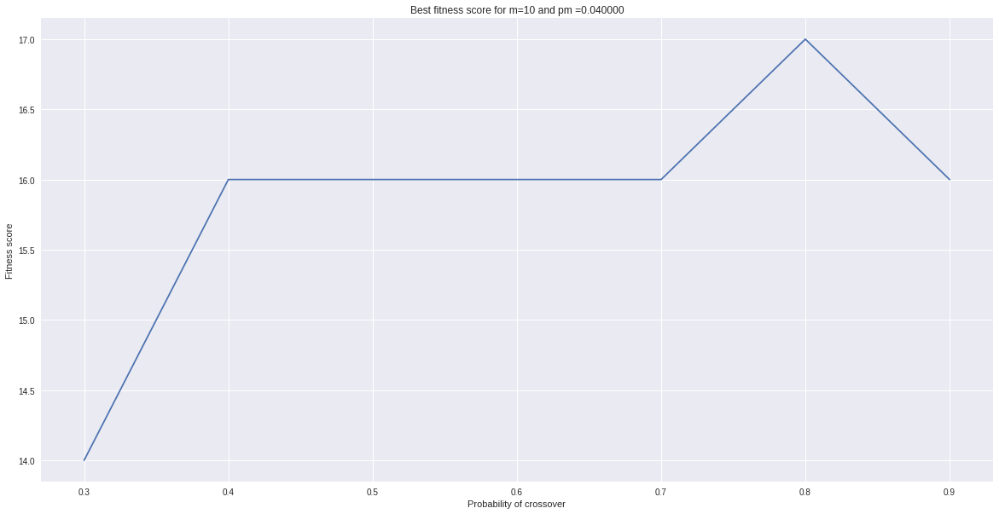

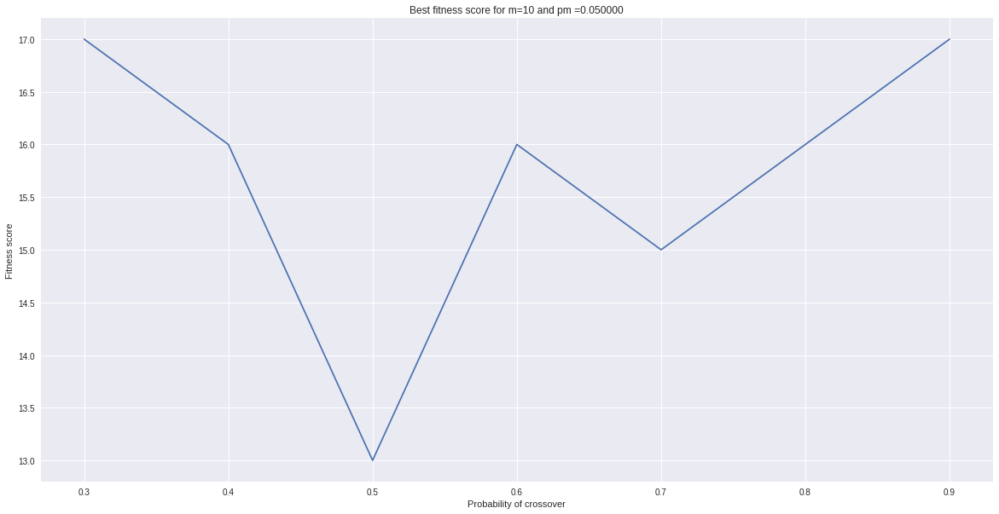

...

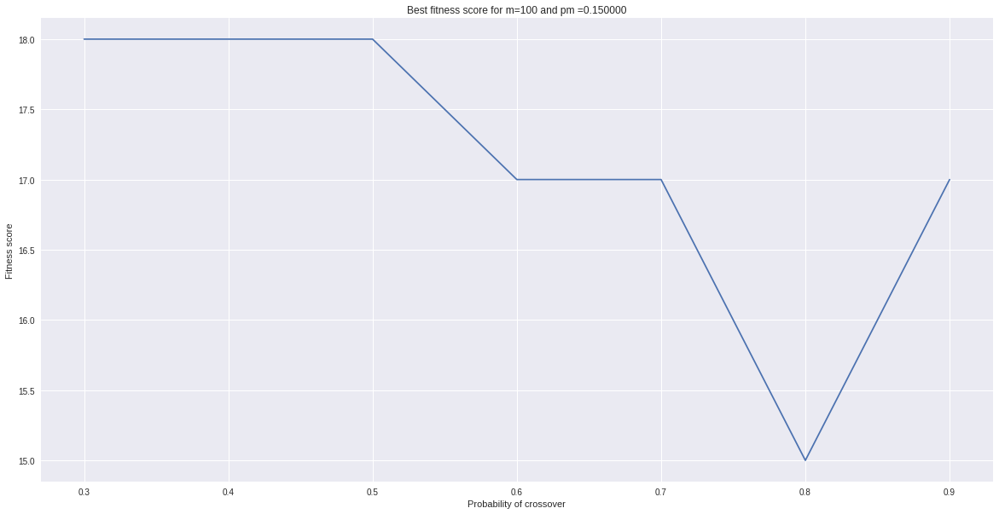

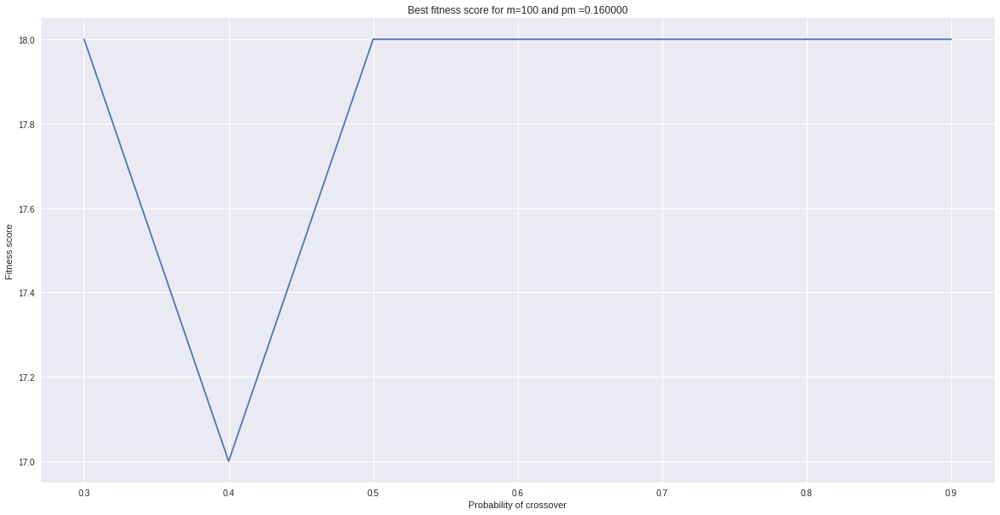

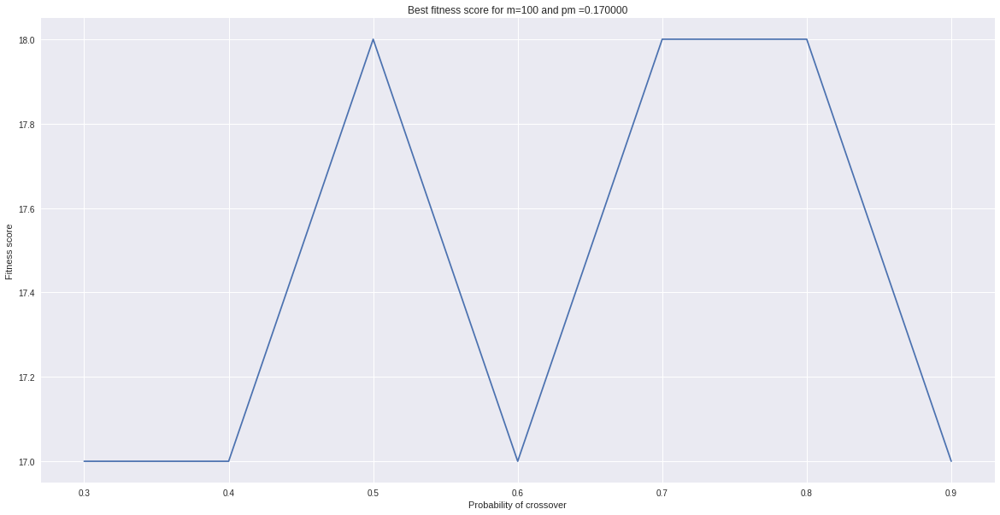

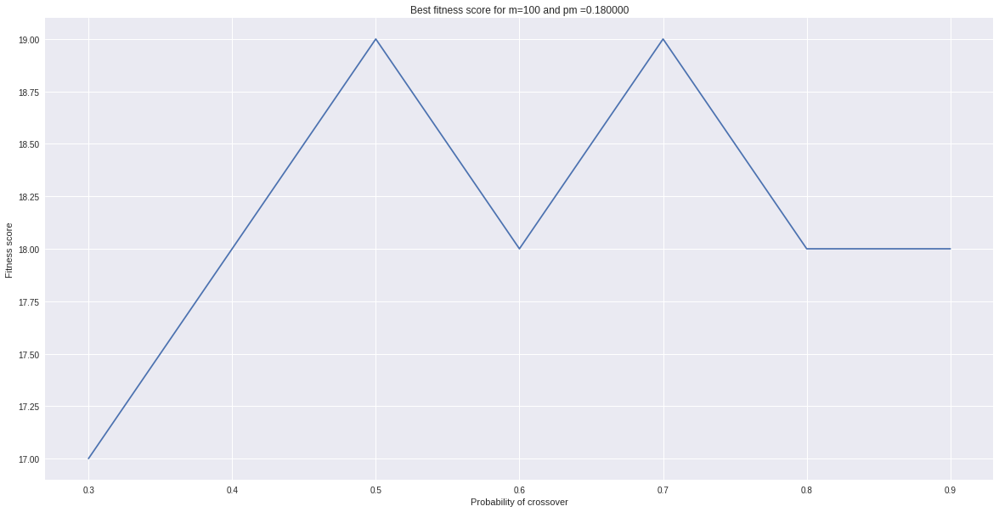

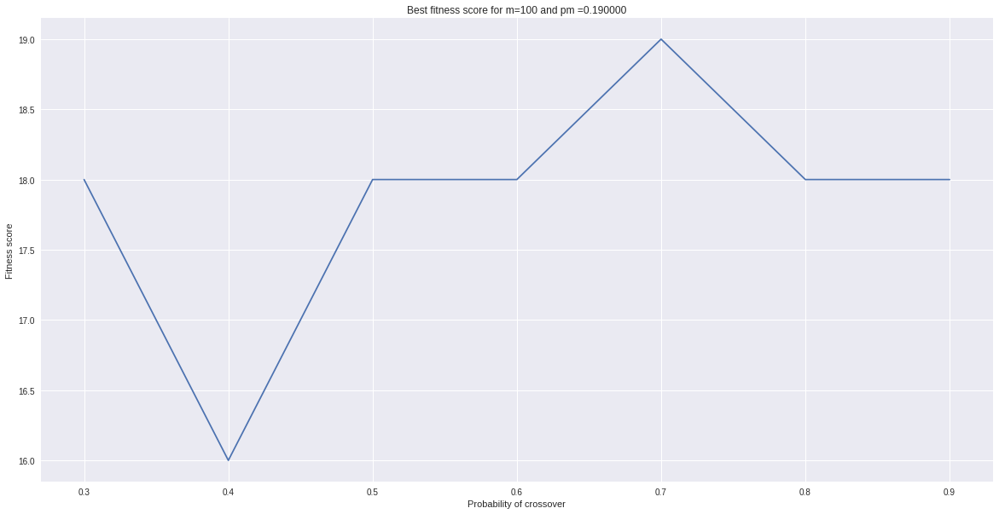

In [0]:
for i in range(len(m_values)):
  for k in range(len(pm_values)):
    plt.figure()
    plt.title("Best fitness score for m=%d and pm =%f" %(m_values[i],pm_values[k]))
    plt.ylabel("Fitness score")
    plt.xlabel("Probability of crossover")
    
    plt.plot(pc_values,gens[i,:,k])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


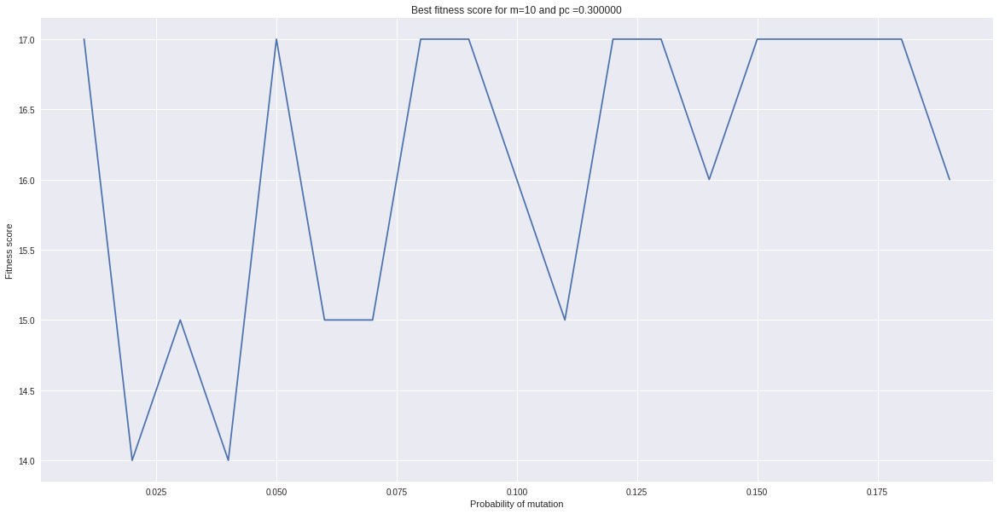

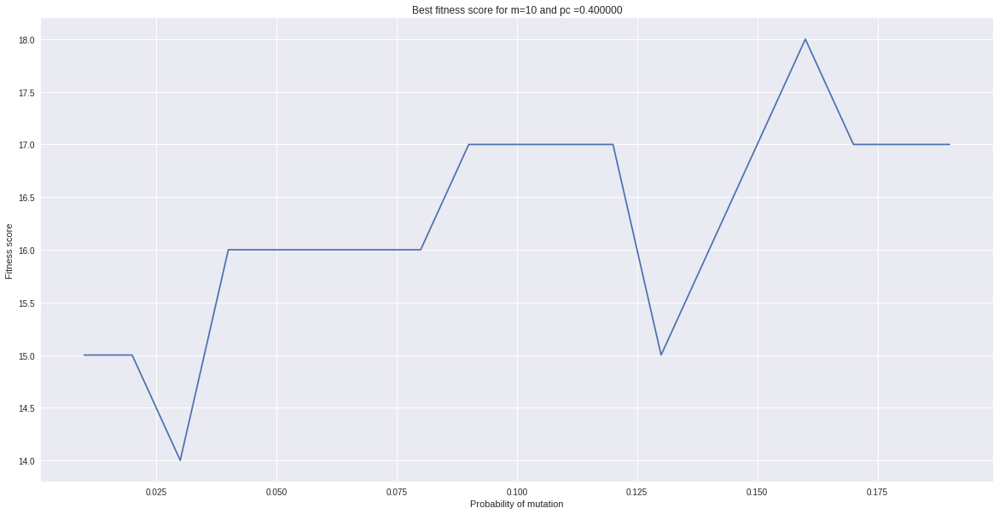

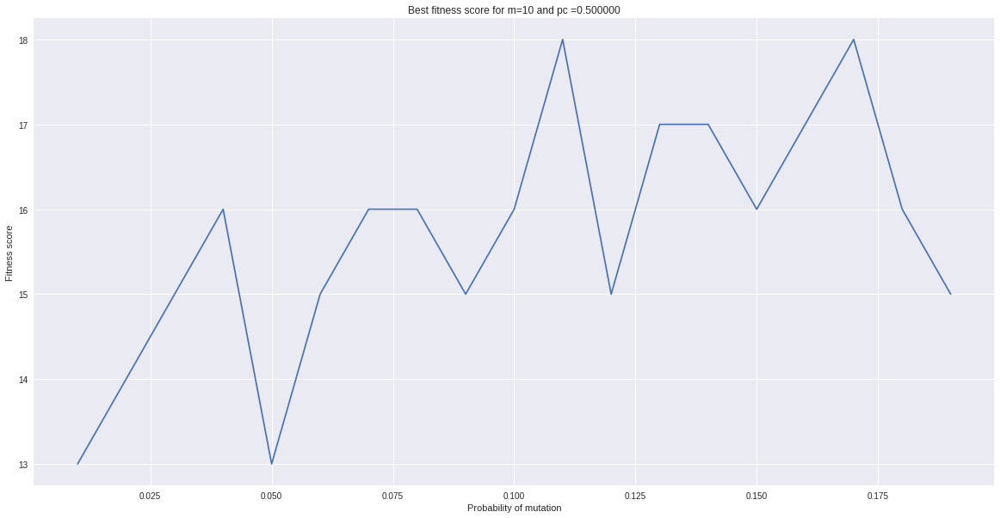

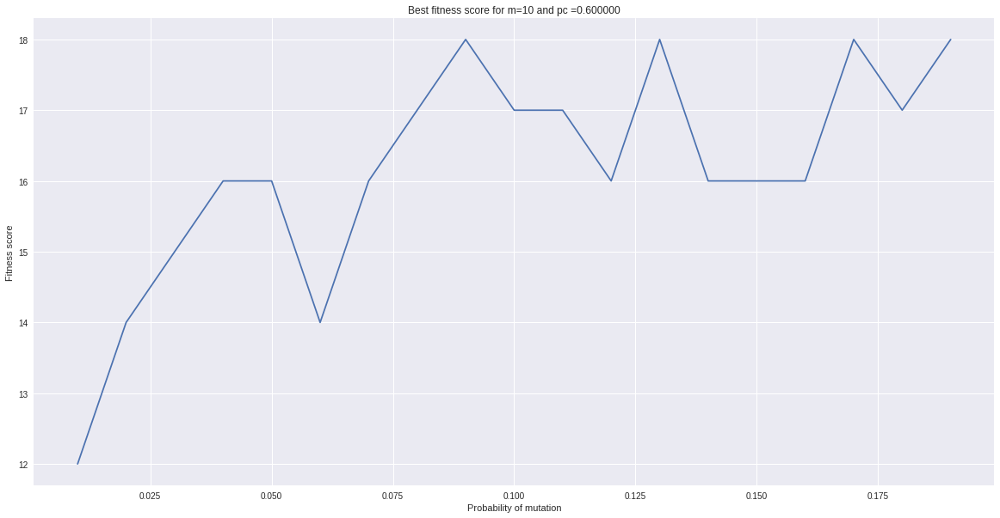

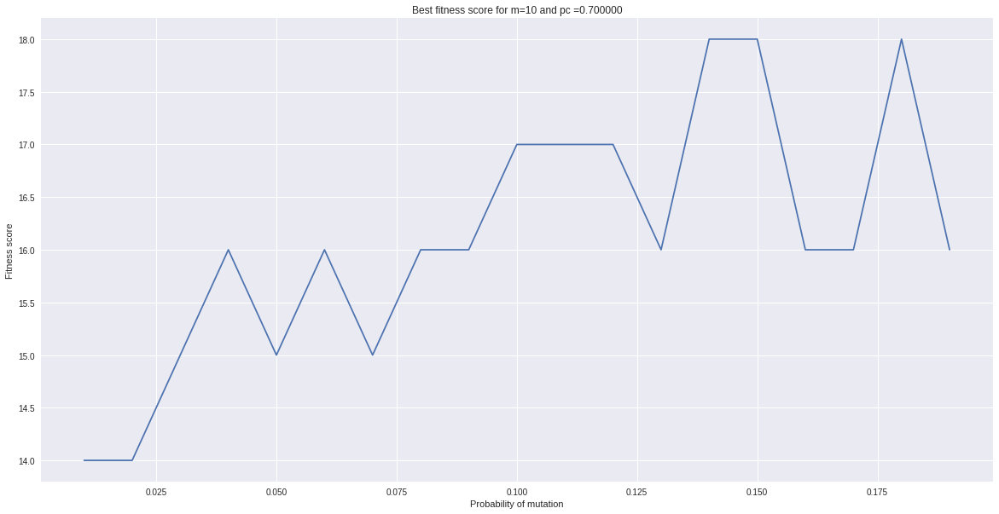

...

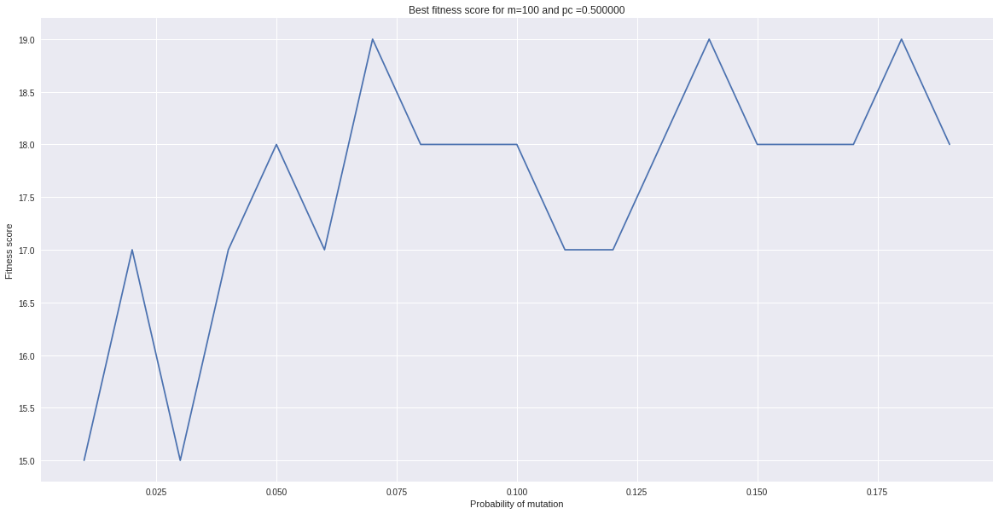

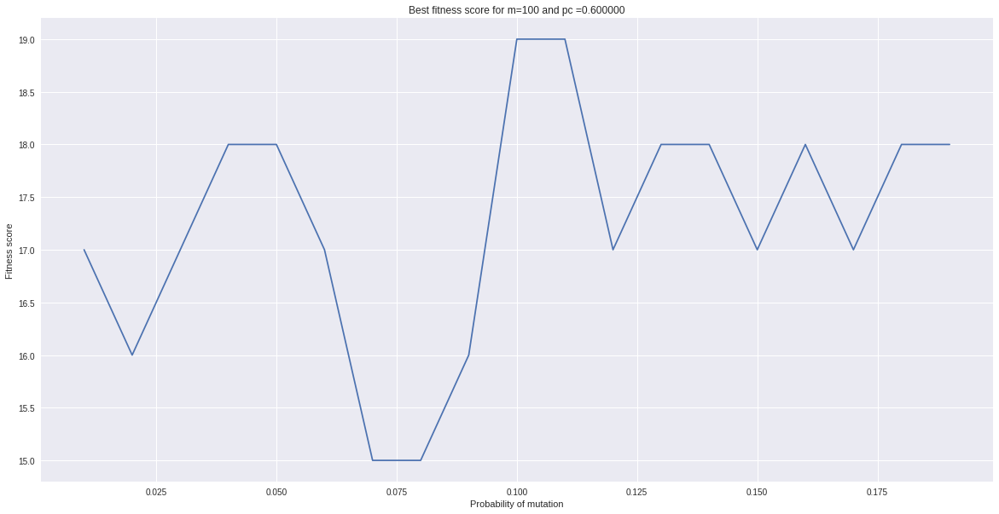

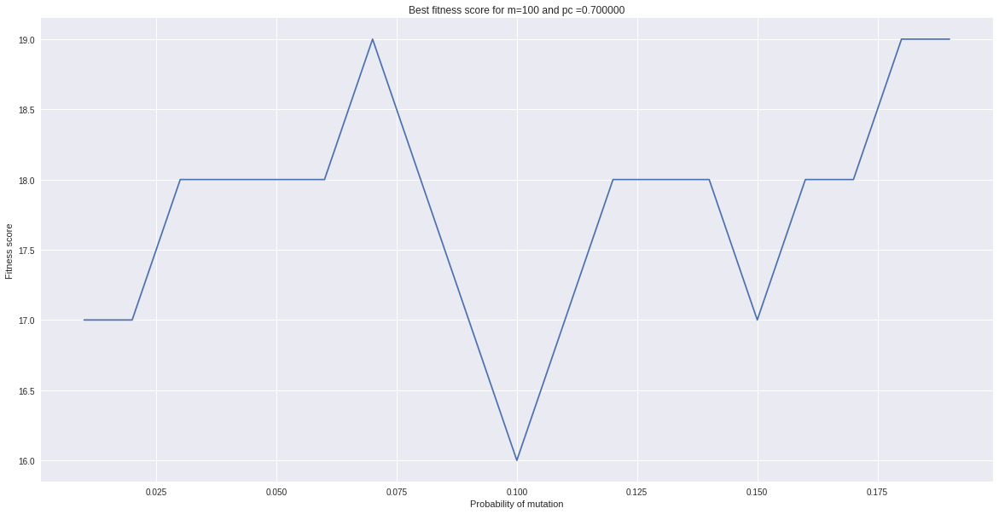

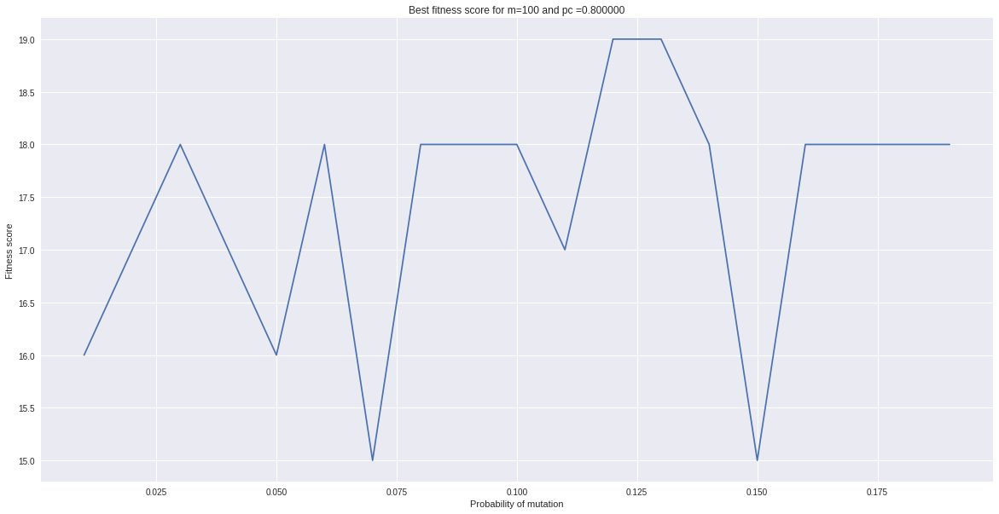

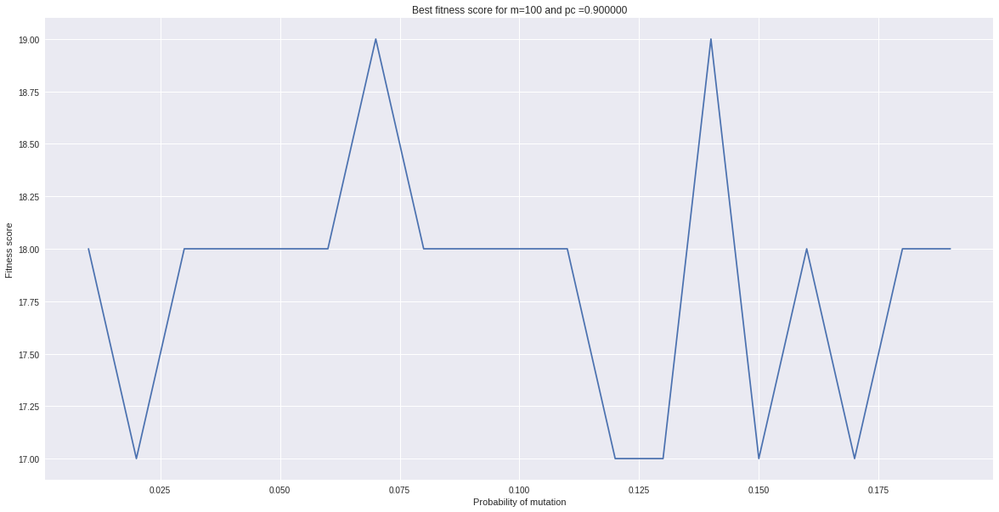

In [0]:
for i in range(len(m_values)):
  for j in range(len(pc_values)):
    plt.figure()
    plt.title("Best fitness score for m=%d and pc =%f" %(m_values[i],pc_values[j]))
    plt.ylabel("Fitness score")
    plt.xlabel("Probability of mutation")
    
    plt.plot(pm_values,gens[i,j,:])

## Results

As we can see, the Genetic Algorithm approaches really close to the optimal solution (solutions: 17,18,19) for most of the parameters' combinations. In addition, as we can see from the plots above there are even two parameters' combinations that lead to the optimal solution (20).


# Part B: Community detection in Social Network Graphs using Genetic Algorithms

In this part of the lab we are going to implement a community detection genetic algorithm [GA-Net](https://link.springer.com/chapter/10.1007/978-3-540-87700-4_107). Then we are going to use this algorithm in order to detect communities in real networks and compare our results with the results of the algorithms in Lab2 using the modularity metric.



## Chromosomes: representation of a solution
Each chromosome $b_{i,t}$ of the population  at time $t$ is a vector with length equal to the number of nodes of the network, $n$. If  $b_{i,t}(j)=d$ then the nodes $j,d$ are assigned to the same community. In addition, $b_{i,t}(j)=d$ only if the nodes $j,d$ are connected in the original topology. Then, by finding the connected components of the chromosome $b_{i,t}$, we find the communities of the network.

## Initialization: initial generation
The initial generation of the population must be consisted of random generated chromosomes. However, these chromosomes must be checked because it is possible that the random generated components could be disconnected in the original graph. Therefore, the number on each of the indexes in a chromosome must be a neighbor node of the corresponding index in the original graph. If it isn't, it must be replaced randomly with a neighbor. We are going to use an initial population of size $300$ chromosomes.





In [0]:
def create_population(m,A):
  # Create the initial population
  n = A.shape[0]
  population= np.random.randint(0,n,(m,n))

  for i in range(m):
    for j in range(n):
      d = population[i,j] 
      if (A[j,d] != 1):        
        neighs = []
        for k in range(n):
          if (A[j,k]==1): neighs.append(k)
        
        pos = random.randint(0,len(neighs)-1)
        population[i,j] = neighs[pos]

  return population

## Fitness Function: performance metric for a chromosome
The fitness function will be calculated using the following procedure as described in the [GA-Net](https://link.springer.com/chapter/10.1007/978-3-540-87700-4_107) paper.

Let $S = (I,J)$ be a sub-matrix of $A$, where $I$ is a subset of the rows {$I_1,...,I_N$} of A, and $J$ is a subset of the columns {$J_1,...,J_N$} of A.<br>
Let $a_{iJ}$ denote the **mean value** of the **i**th row of the $S$, and $a_{Ij}$ the mean of the **j**th column of $S$. <br>
$$a_{iJ} = {1 \over |J|} \sum_{j \in J} a_{ij}$$ and $$a_{Ij} = {1 \over |I|} \sum_{i \in I} a_{ij}$$

The volume $u_S$ of a sub-matrix $S=(J,J)$ is the number of 1 entries $a_{ij}$ such that $i \in I$ and $j \in J$, that is $u_S = \sum_{i \in I,j \in J} a_{ij}$

Given a sub-matrix $S=(I,J)$, the power mean of $S$ of order $r$, denoted as $M(S)$ is defined as $$M(S)= {{\sum_{i \in I} (a_{iJ})^r} \over |I|}$$

**Definition of the fitness function**

The *score* of $S$ is defined as $Q(S) = M(S) \times u_S$. <br>
The *community score* of a partitioning {$S_1,...,S_k$} of A is defined as $$ CS = \sum_i^k Q(S_i) $$



In [0]:
def find_connected_subgraphs(G):
  return list(G.subgraph(c) for c in nx.connected_components(G))

def find_fitness(population,r,A):
  # Calculate fitness of chromosomes
  m,n = population.shape
  fits = []
  for i in range(m):
    adj = np.zeros((n,n))
    for j in range(n):
      adj[j,int(population[i,j])] = 1
      adj[int(population[i,j]),j] = 1 

    G = nx.from_numpy_array(adj)

    subgraphs = find_connected_subgraphs(G)
    coms = [list(subgraph.nodes()) for subgraph in subgraphs]  

    CS = 0
    for com in coms:
      row_idx = np.array(com)
      col_idx =  np.array(com)
      sub = A[row_idx[:, None], col_idx]

      us = sum(sum(sub))
      M = sum(np.power(np.mean(sub,axis=1),r))/len(sub)

      CS = CS + M*us

    fits.append(CS)

  return fits

## Selection: generalized roulette wheel method
The selection of the chromosomes from a generation for the creation of the next generation is handled by the [generalized roulette wheel selection](https://en.wikipedia.org/wiki/Fitness_proportionate_selection). We will modify this algorithm in order to apply elitism, which means that the first $x$ chromosomes of a new generation will be the chromosomes of the previous generation that achieved the best values in regard to the fitness function.


In [0]:
def proportional_selection(elite, population, fit ):
  # Select chromosomes to pass to next population proportionally to their fitness
  elites = np.argsort(fit)
  new_pop = np.zeros(population.shape)

  p = []
  s = sum(fit)
  for fit_score in fit:
    p.append(fit_score/s)

  for i in range(1,elite+1):
    pos = elites[-i]
    new_pop[i-1,:] = population[pos,:]

  for i in range(elite,population.shape[0]):
    x = random.uniform(0,1)
    k=0
    while k<population.shape[0]-1 and x > sum(p[0:k]):
      k=k+1
    
    new_pop[i,:] = population[k,:]
  
  return new_pop

## Crossover
We apply [Uniform crossover](https://en.wikipedia.org/wiki/Crossover_(genetic_algorithm)) with a probability of crossover equal to $p_C$


In [0]:
def crossover(pc, population):
  # Apply crossover to population
  new_pop = np.zeros(population.shape)
  for i in range(population.shape[0]):
    if random.uniform(0,1) < pc:
      chroms = np.zeros((2,population.shape[1]))
      chroms[0,:] = population[i,:] 
      parent2 = random.randint(0,population.shape[0]-1)
      chroms[1,:] = population[parent2,:]
      mask = np.random.randint(0,1,(population.shape[1]))

      for j in range(len(mask)):
        new_pop[i,j] = chroms[mask[j],j]
      
    else:
      new_pop[i,:] = population[i,:]

  return new_pop

## Mutation
We apply mutation on a random index in a chromosome with a probability of mutation equal to $p_M$. However, we have to modify the algorithm in order for the mutated gene to be a neighbor of the index in the original graph.




In [0]:
def mutation(pm, population, A):
  # Apply mutation to population
  for i in range(population.shape[0]):
    if random.uniform(0,1) < pm:
      pos = random.randint(0, population.shape[1]-1)
      neighs = []
      for k in range(A.shape[1]):
        if A[pos,k] == 1: neighs.append(k)
      
      new_genoid = neighs[random.randint(0,len(neighs)-1)]

      population[i,pos] = new_genoid

  return population

## Stopping Criterion
As a stopping criterion we are going to set a maximum number of 
repetitions of the algorithm (maximum number of generations) equal to $30$, or that the optimal value of the fitness function doesn't change for $5$ consecutive repetitions. 



## Chromosome into communities

In order to find the communities that a chromosome represents, we find the connected components it forms. Then each connected component is equivalent to a community. 

In [0]:
def get_coms(chrom):
  n = len(chrom)
  adj = np.zeros((n,n))
  for j in range(n):
    adj[j,int(chrom[j])] = 1
    adj[int(chrom[j]),j] = 1 

  G = nx.from_numpy_array(adj)

  subgraphs = find_connected_subgraphs(G)

  coms = [list(subgraph.nodes()) for subgraph in subgraphs]

  return coms

## Verbose output
We use the following function to print information about each generation. 

In [0]:
def print_gen_info(population,fit,t,verb):
  best = np.argmax(fit)
  print('Generation %d max fitness: %f' %(t,fit[best]))
  if (verb==2):
    for i in range(len(population)):
      print("Chromosome #%d   fitness: %f" %(i,fit[i]))
  print('Average fitness: %f\n' %np.mean(fit))

## Genetic Algorithm: main function

In [0]:
# The function below is an implementation of the GA-Net
#
# Parameters:
#   -G: the input Graph
#   -m: population size 
#   -elitism: number of elite chromosomes
#   -r: order r for the fitness function
#   -pc: probability of crossover
#   -pm: probability of mutation
#   -verb: verbose output (0,1 or 2)
#
# Output:
#   -gens: a list of the best chromosomes for each generation along with its fitness function
#   -best_chrom: the best chromosome of all the generations
#   -coms: the communities detected by the best chromosome

def genetic_algorithm(G,m,elitism,r,pc,pm,verb):
  A = nx.to_numpy_array(G)
  n = A.shape[0]
  gens = []
  t=0

  population = create_population(m,A)
  fit = find_fitness(population,r,A)
  if verb: print_gen_info(population,fit,t,verb)

  best = np.argmax(fit)
  cnt = 1
  old_best = fit[best]
  gens.append((population[best,:], fit[best]))

  while t<30 and cnt<=5: 
    t=t+1
    sel_pop = proportional_selection(elitism, population, fit)
    cross_pop = crossover(pc, sel_pop)
    population = mutation(pm, cross_pop,A)

    fit = find_fitness(population,r,A)

    if verb: print_gen_info(population,fit,t, verb)

    best = np.argmax(fit)
    
    if fit[best] == old_best: cnt=cnt+1
    else:
      old_best = fit[best]
      cnt=1

    gens.append((population[best,:], fit[best]))

  best_chrom = sorted(gens, key=lambda x: x[1], reverse=True)[0]
  coms = get_coms(best_chrom[0])

  return gens, best_chrom, coms

## Running the Genetic Algorithm

We are going to run the genetic algorithm for the real topologies of Lab2 (presented in the table below). 

Real topologies found on <a style=text-decoration:none href="http://www-personal.umich.edu/~mejn/netdata/">http://www-personal.umich.edu/~mejn/netdata/</a> 

<table style=width:100%>
<tr>
    <th style=text-align:left>Topology</th>
    <th style=text-align:left>File</th>
    <th style=text-align:left>Description</th>
</tr>
<tr>
    <td style=text-align:left>American College Football</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/football.zip'>football.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>football.gml</b> contains the network of American football games between Division IA colleges during regular season Fall 2000, as compiled by M. Girvan and M. Newman. The nodes have values that indicate to which conferences they belong.</p>
    </td>
</tr>
<tr>
    <td style=text-align:left>Les Miserables</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/lesmis.zip'>lesmis.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>lesmis.gml</b> contains the weighted network of coappearances of
characters in Victor Hugo's novel "Les Miserables".  Nodes represent characters as indicated by the labels and edges connect any pair of characters that appear in the same chapter of the book.  The values on the edges are the number of such coappearances.  The data on coappearances were taken from D. E. Knuth, The Stanford GraphBase: A Platform for Combinatorial Computing, Addison-Wesley, Reading, MA (1993)</p>
    </td>
</tr>  
<tr>
    <td style=text-align:left>Dolphin social network</td>
    <td style=text-align:left><a style=text-decoration:none href='http://www-personal.umich.edu/~mejn/netdata/dolphins.zip'>dolphins.gml</a></td>
    <td style=text-align:left><p style=text-align:justify> The file <b>dolphins.gml</b> contains an undirected social network of frequent associations between 62 dolphins in a community living off Doubtful Sound, New Zealand, as compiled by Lusseau et al. (2003)</p>
    </td>
</tr> 
</table>

We are going to use different parameter values on every run. We will use all the combinations below:

<table style=width:100%>
<tr>
    <th style=text-align:left>Parameter</th>
    <th style=text-align:left>Values</th>
</tr>
<tr>
    <td style=text-align:left>Crossover <b>p<sub>c</sub></b></td>
    <td style=text-align:left><b>[0.7,0.9]</b> with step <b>0.1</b></td>
</tr>
<tr>
    <td style=text-align:left>Mutation <b>p<sub>M</sub></b></td>
    <td style=text-align:left><b>{0.1,0.2}</b></td>
</tr>
<tr>
    <td style=text-align:left>Elitism <b>x</b></td>
    <td style=text-align:left><b>[1,3]</b> with step <b>1</b></td>
</tr>
</table>


### Importing the real topologies

In [0]:
# Import real topologies 

football_gml = nx.read_gml("./football.gml")
lesmis_gml = nx.read_gml("./lesmis.gml")
dolphins_gml = nx.read_gml("./dolphins.gml")

def conv2int(G,start_value):
    nG = nx.convert_node_labels_to_integers(G, first_label=start_value)
    G_mapping = dict(enumerate(G.nodes,0))
    return nG,G_mapping

football, football_map = conv2int(football_gml,0)
lesmis, lesmis_map = conv2int(lesmis_gml,0)
dolphins, dolphins_map = conv2int(dolphins_gml,0)

### Running the Genetic Algorithm

In [0]:
# Run the genetic algorithm for different values of the requested parameters
pc_values = np.arange(0.7,0.9,0.1)
pm_values = [0.1,0.2]
elitism_values = list(range(1,4))

def run_genetic(G,m,elite,r,pc,pm,verb):
  results = np.zeros((len(pc), len(pm), len(elite)))
  best_fit = 0
  best_coms = None
  for i in range(len(pc)):
    for j in range(len(pm)):
      for k in range(len(elite)):
        _, best, nodes = genetic_algorithm(G, m, elite[k] , r, pc[i], pm[j], verb)
        results[i,j,k] = best[1]

        if best[1] > best_fit:
          best_fit = best[1]
          best_coms = nodes
  
  return results, best_coms

football_results, football_coms = run_genetic(football, 300, elitism_values, 1.2, pc_values, pm_values, 0)
lesmis_results, lesmis_coms = run_genetic(lesmis, 300, elitism_values, 2, pc_values, pm_values, 0)
dolphins_results, dolphins_coms = run_genetic(dolphins, 300, elitism_values, 1, pc_values, pm_values, 0)


### Function to compute modularity

In [0]:
# modularity for GA community detection algorithm 
def compute_modularity(G, G_results):
  mod = nx.algorithms.community.quality.modularity(G,G_results)
  n_coms = len(G_results)

  return n_coms, mod

In [0]:
football_gen_num, football_gen_mod = compute_modularity(football, football_coms)
lesmis_gen_num, lesmis_gen_mod = compute_modularity(lesmis, lesmis_coms)
dolphins_gen_num, dolphins_gen_mod = compute_modularity(dolphins, dolphins_coms)

### Functions to plot the evolution of the GA's solutions

In [0]:
def plot_elite(G_results):
  gs = gridspec.GridSpec(len(pc_values), len(pm_values))
  fig = plt.figure(figsize=(20,15))
  for i in range(len(pc_values)):
    for j in range(len(pm_values)):
      ax = fig.add_subplot(gs[i, j])
      ax.set_title("Best fitness score for pc=%f and pm =%f" %(pc_values[i],pm_values[j]))
      ax.set_ylabel("Fitness score")
      ax.set_xlabel("Elite chromosomes")
      
      plt.plot(elitism_values, G_results[i,j,:])

  plt.show()

def plot_pc(G_results):
  gs = gridspec.GridSpec(len(pm_values), len(elitism_values))
  fig = plt.figure(figsize=(20,15))
  for j in range(len(pm_values)):
    for k in range(len(elitism_values)):
      ax = fig.add_subplot(gs[j, k])
      ax.set_title("Best fitness score for pm=%f and elite =%f" %(pm_values[j],elitism_values[k]))
      ax.set_ylabel("Fitness score")
      ax.set_xlabel("Probability of crossover")
      
      plt.plot(pc_values, G_results[:,j,k])

  plt.show()

def plot_pm(G_results):
  gs = gridspec.GridSpec(len(pc_values), len(elitism_values))
  fig = plt.figure(figsize=(20,15))
  for i in range(len(pc_values)):
    for k in range(len(elitism_values)):
      ax = fig.add_subplot(gs[i, k])
      ax.set_title("Best fitness score for pc=%f and elite =%f" %(pc_values[i],elitism_values[k]))
      ax.set_ylabel("Fitness score")
      ax.set_xlabel("Probability of mutation")
      
      plt.plot(pm_values, G_results[i,:,k])
  
  plt.show()


### Results

#### Football graph

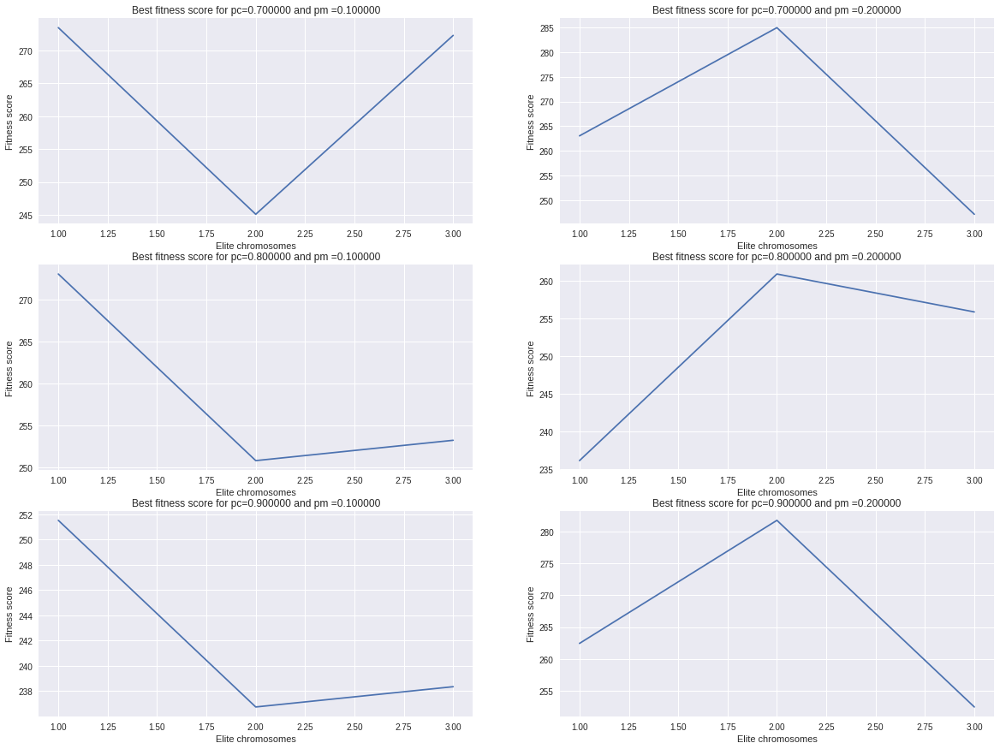

In [0]:
#FOOTBALL graph
plot_elite(football_results)

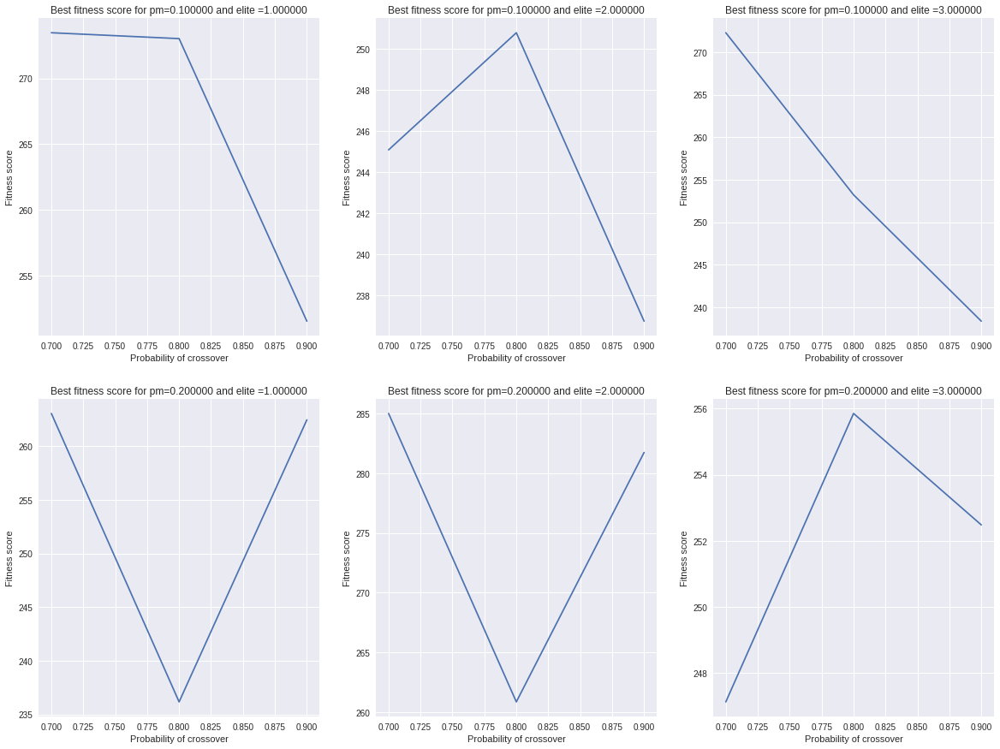

In [0]:
#FOOTBALL graph
plot_pc(football_results)

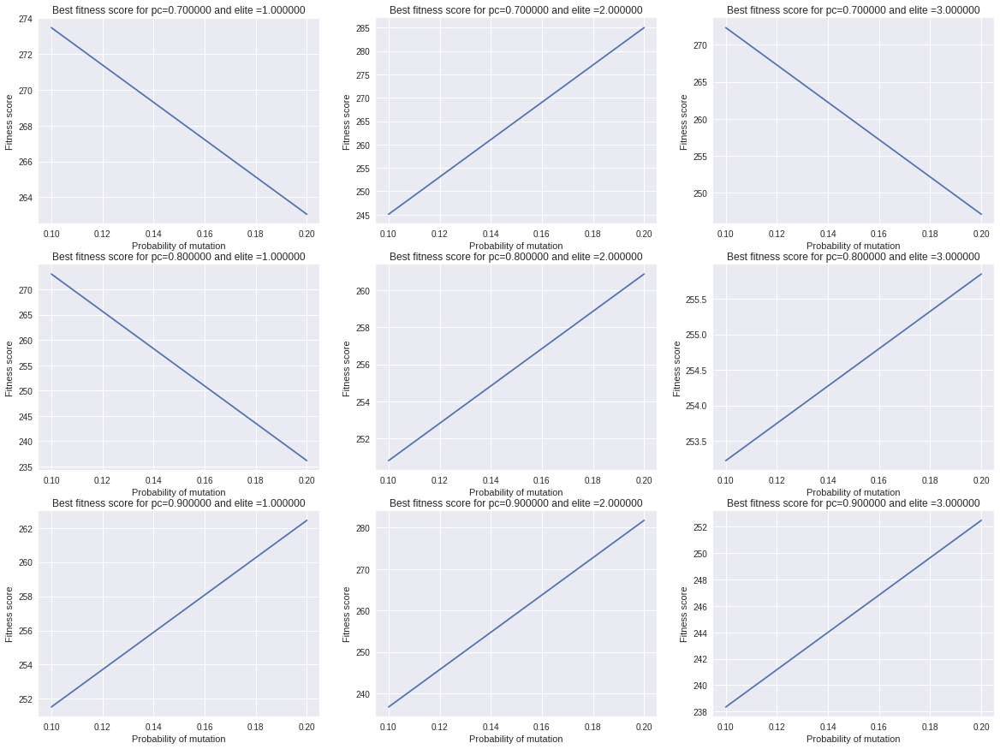

In [0]:
#FOOTBALL graph
plot_pm(football_results)

#### Lesmis graph

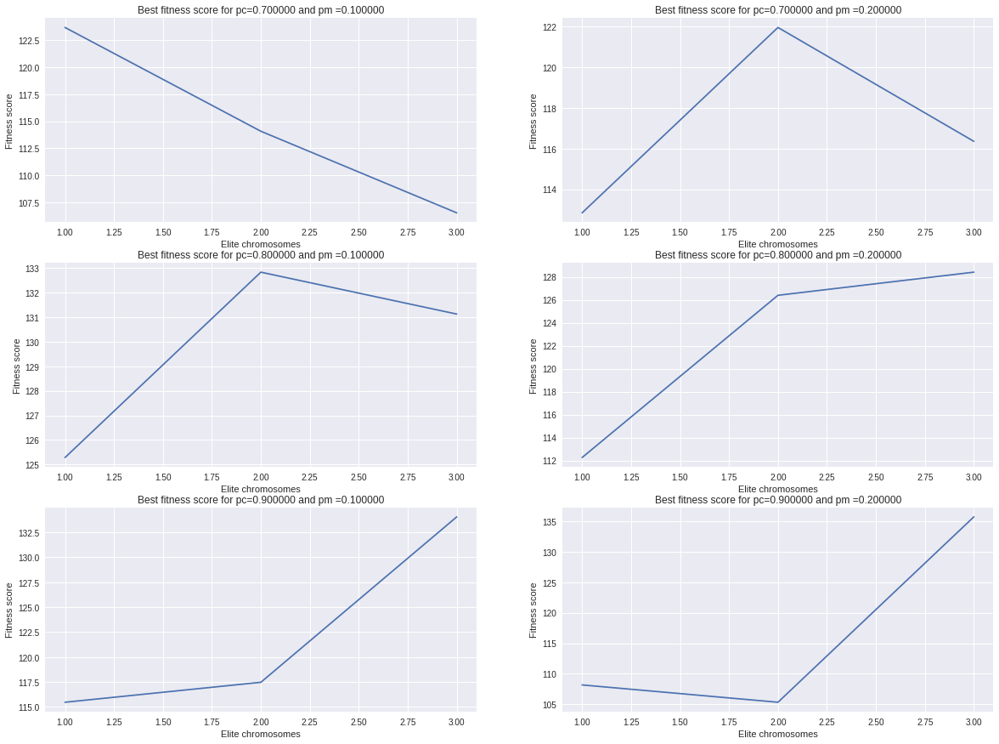

In [0]:
#LESMIS graph
plot_elite(lesmis_results)

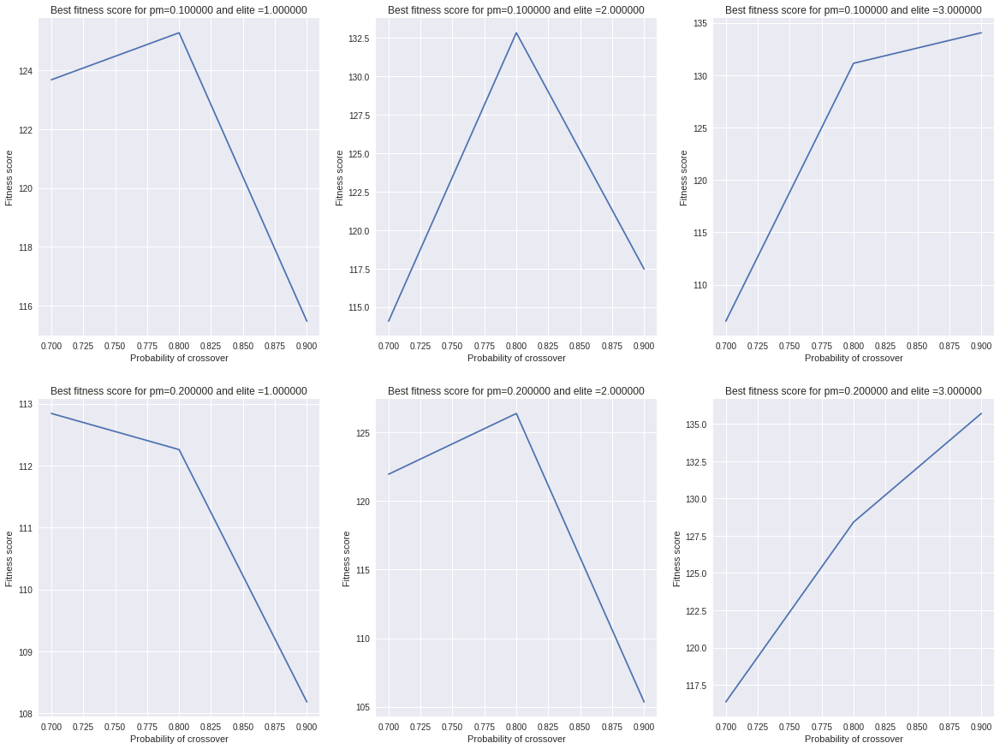

In [0]:
#LESMIS graph
plot_pc(lesmis_results)

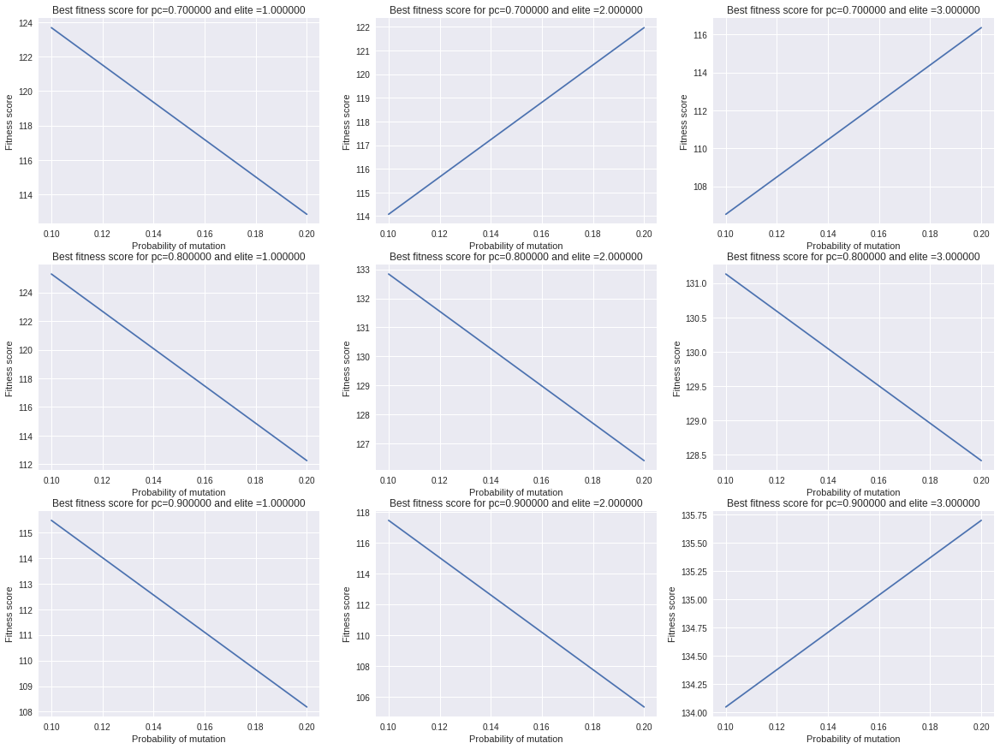

In [0]:
#LESMIS graph
plot_pm(lesmis_results)

#### Dolphins graph

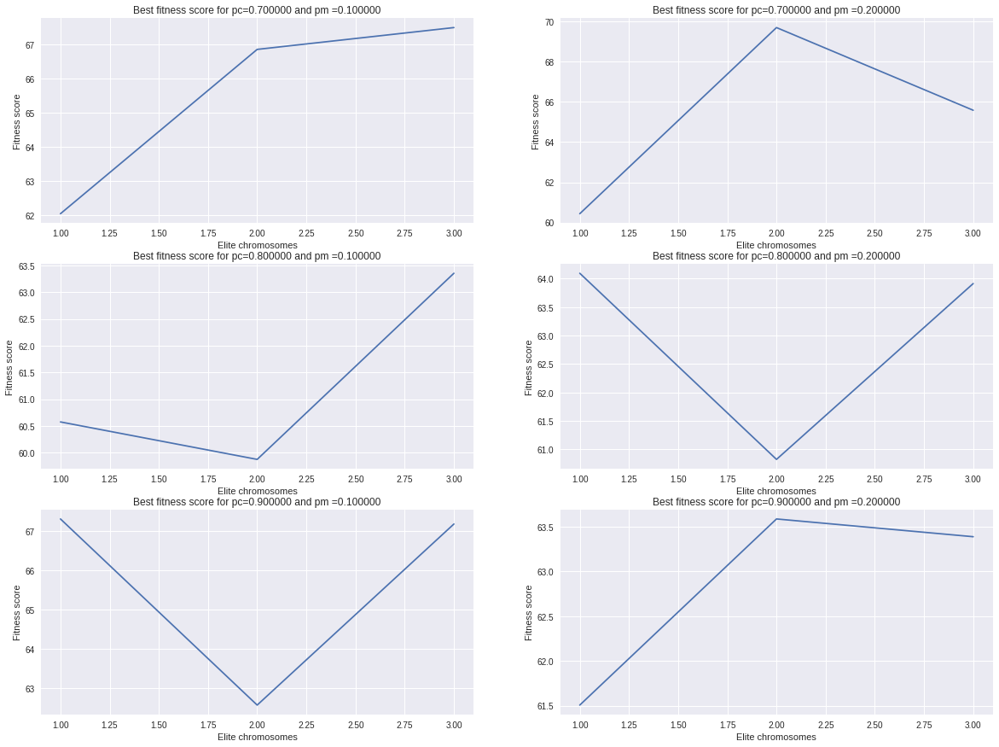

In [0]:
#DOLPHINS graph
plot_elite(dolphins_results)

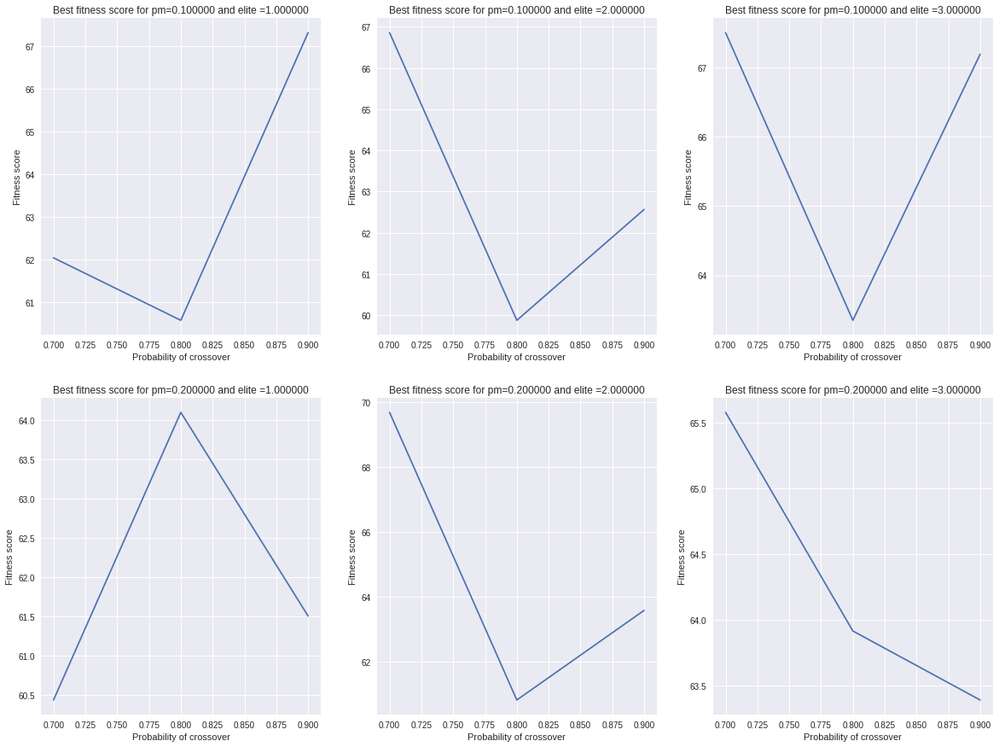

In [0]:
#DOLPHINS graph
plot_pc(dolphins_results)

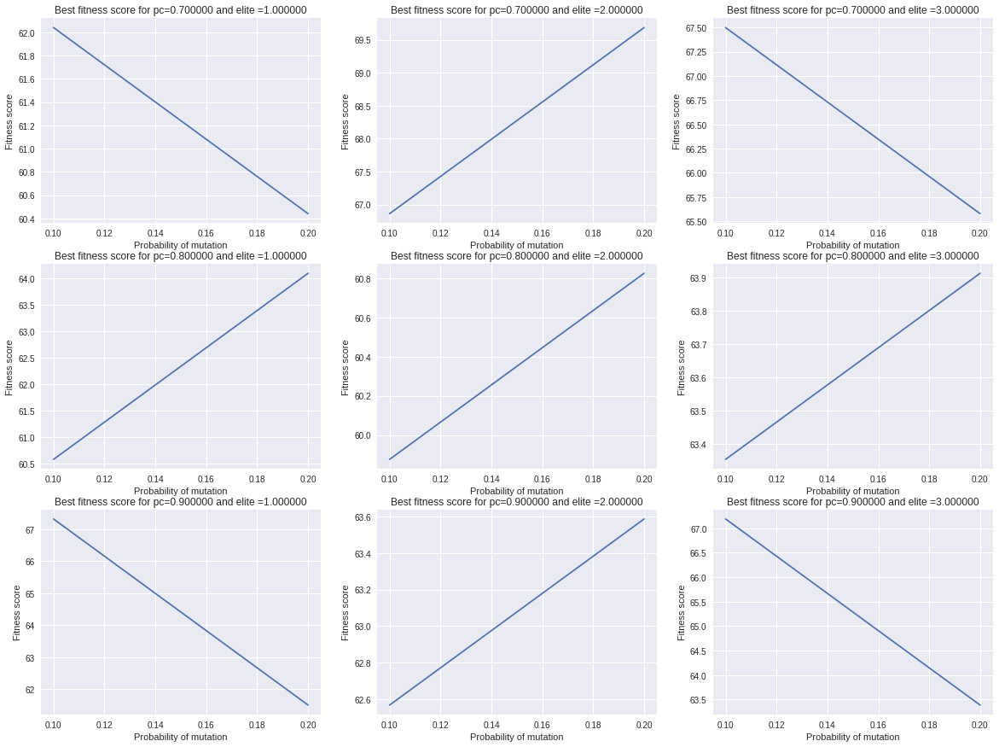

In [0]:
#DOLPHINS graph
plot_pm(dolphins_results)

### Comments on the results

- Football Graph
  - Elite chromosomes: We can see that when the probability of mutation is equal to 0.1, the best fitness score is achieved when only one chromosome is passed intact to the next generation (elite). On the contrary, when the probability of mutation is increased to 0.2, the best fitness scores are achieved with 2 elite chromosomes. Therefore, in the case of the American Football Graph we notice that the mutation of the genes doesn't really help the algorithm to approach the optimal solution.
  
  - Probability of crossover: Based on the plots above, the best value for the probability of crossover is equal to 0.7 regardless of the values of the other two parameters.

  - Probability of mutation: We notice that while the probability of mutation is increasing, the performance of the genetic algorithm is getting lower if the other two parameters stay intact. On the other hand, if the other two parameters are increased accordingly, then the performance gets better.

- Lesmis Graph
  - Elite chromosomes: In the case of the Les Miserable Graph, increasing the number of elite chromosomes to 2 is conducive for the performance of the algorithm only if the probability of crossover is low or we have a high probability of mutation. If we set the number of elite chromosomes equal to 3, then the genetic algorithm performs better only if we have a high probability of crossover and mutation at the same time, which leads to information loss from our "good" chromosomes.

  - Probability of crossover: As we mentioned above, in the LesMis graph, the good chromosomes seem to help the genetic algorithm approach faster the optimal solution. Therefore we notice that when the probability of mutation is low, the best results are achieved with a medium probability of crossover. On the contrary, if we increase the probability of mutation, we have to decrease the probability of crossover in order to get better results.

  - Probability of mutation: Further to the above observations, we notice that there is a threshold for the probabilities of mutation and crossover and if we pass it, we have to increase the number of the elite chromosomes in order for our genetic algorithm to perform well.

- Dolphins Graph
  - Elite chromosomes: In the case of the Dolphins graph, we notice that the elite chromosomes contribute even more in the performance of the genetic algorithm. Even in the case with the lowset probabilities of mutation and crossover, the algorithm performs the best fitness score with the number of elite chromosomes equal to 3.

  - Probability of crossover: As expected, based on our observations above, increasing the probability of crossover leads to a decrease in the performance of the algorithm, with an exception in the case where we have a low probability of mutation and a number of elite chromosomes equal to 1 in which we need the 
diversity. 
  
  - Probability of mutation: The best performance of the genetic algorithm is achieved when the probability of mutation is equal to 0.2, its maximum value.


## Common Community Detection Algorithms
We are going to use the community detection methods of Lab2 to find the communities of the real topologies and compare their results with our genetic algorithm's results.


<table style=float:left;width:70%>
    <tr>
        <th style=text-align:left> Community detection algorithm</th>
        <th style=text-align:left>Function</th>
    </tr>
    <tr>
        <td style=text-align:left>Spectral Clustering</td>
        <td style=text-align:left><a style=text-decoration:none href='http://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html'>SpectralClustering</a></td>
    </tr>
       <tr>
        <td style=text-align:left>Newman-Girvan</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.centrality.girvan_newman.html'>girvan_newman</a></td>
    </tr>
    <tr>
        <td style=text-align:left>Modularity Maximization</td>
        <td style=text-align:left><a style=text-decoration:none                               href='https://networkx.github.io/documentation/latest/reference/algorithms/generated/networkx.algorithms.community.modularity_max.greedy_modularity_communities.html'>greedy_modularity_communities</a></td>
    </tr>
</table>
    

### Girvan-Newman

In [0]:
import itertools

# Girvan_newman:partitions of at most k communities, select the one with the highest value of modularity.
def comd_GN(G,k):
    gn_G = nx.algorithms.community.centrality.girvan_newman(G)
    limited = itertools.takewhile(lambda c: len(c) <= k, gn_G)
    per_G = []
    com_G = []
    for communities in limited:
        per = nx.algorithms.community.quality.modularity(G,communities)
        per_G.append(per) #list of performance of each partition
        com_G.append(communities) # list of partitions
    max_mod_G = max(per_G) # maximum modularity value
    index_G = per_G.index(max(per_G)) # index of maximum modularity
    best_G = com_G[index_G] # the partition of maximum modularity  
    num_best_G = len(best_G)
    return best_G, max_mod_G, num_best_G

GN_best_football, GN_mod_football, GN_num_football = comd_GN(football,50)
GN_best_lesmis, GN_mod_lesmis, GN_num_lesmis = comd_GN(lesmis,50)
GN_best_dolphins, GN_mod_dolphins, GN_num_dolphins = comd_GN(dolphins,50)

### Spectral Clustering

In [0]:
from sklearn.cluster import SpectralClustering

# Spectral Clustering
def comd_SP(G,k):
    mG = np.array(nx.to_numpy_matrix(G))
    clustering = SpectralClustering(n_clusters=k,random_state=0, affinity='precomputed').fit(mG)
    clabels = clustering.labels_
    numc = clustering.n_clusters
    b = dict(enumerate(clabels,0)) # create a mapping of nodes indices to the community it belongs
    d = [] # a list of all communities (each list is a community)
    for i in range(0,numc):
        d.append([k for k,v in b.items() if float(v) == i])
    per = nx.algorithms.community.quality.modularity(G,d)
    return d, per, numc

def find_best_SP_partition(G,k):
    com = []
    com_mod = []
    com_num = []
    for i in range(2,k):
        tcom,tcom_mod,tcom_num = comd_SP(G,i)
        com.append(tcom)
        com_mod.append(tcom_mod)
        com_num.append(tcom_num)
    index = com_mod.index(max(com_mod))
    G_SP = com[index]
    G_SP_mod = com_mod[index]
    G_SP_num = com_num[index]
    return G_SP, G_SP_mod, G_SP_num

football_SP, football_SP_mod, football_SP_num = find_best_SP_partition(football,50) 
lesmis_SP, lesmis_SP_mod, lesmis_SP_num = find_best_SP_partition(lesmis,50)  
dolphins_SP, dolphins_SP_mod, dolphins_SP_num = find_best_SP_partition(dolphins,50)

### Modularity Maximization

In [0]:
# Modularity Maximization
def comd_MM(G):
    c = list(nx.algorithms.community.modularity_max.greedy_modularity_communities(G))
    mm_G = []
    for i,j in enumerate(c):
        a = list(j)
        mm_G.append(a)
    per = nx.algorithms.community.quality.modularity(G,mm_G)
    num_G = len(mm_G)
    return mm_G, per,num_G

football_MM, football_MM_mod, football_MM_num = comd_MM(football)
lesmis_MM, lesmis_MM_mod, lesmis_MM_num = comd_MM(lesmis)  
dolphins_MM, dolphins_MM_mod, dolphins_MM_num = comd_MM(dolphins)

## Αggregated results for all algorithms

In [0]:
# Compare results 
print ("American College Football")
print ("Girvan-Newman: %r communities with modularity score %r" %(GN_num_football, GN_mod_football))
print ("Spectral Clustering: %r communities with modularity score %r" %(football_SP_num, football_SP_mod))
print ("Modularity Maximization: %r communities with modularity score %r" %(football_MM_num, football_MM_mod))
print ("Genetic Algorithm: %r communities with modularity score %r" %(football_gen_num,football_gen_mod))
print()
print ("Les Miserables")
print ("Girvan-Newman: %r communities with modularity score %r" %(GN_num_lesmis, GN_mod_lesmis))
print ("Spectral Clustering: %r communities with modularity score %r" %(lesmis_SP_num, lesmis_SP_mod))
print ("Modularity Maximization: %r communities with modularity score %r" %(lesmis_MM_num, lesmis_MM_mod))
print ("Genetic Algorithm: %r communities with modularity score %r"%(lesmis_gen_num,lesmis_gen_mod))
print()
print ("Dolphins")
print ("Girvan-Newman: %r communities with modularity score %r" %(GN_num_dolphins, GN_mod_dolphins))
print ("Spectral Clustering: %r communities with modularity score %r" %(dolphins_SP_num, dolphins_SP_mod))
print ("Modularity Maximization: %r communities with modularity score %r" %(dolphins_MM_num, dolphins_MM_mod))
print ("Genetic Algorithm: %r communities with modularity score %r" %(dolphins_gen_num,dolphins_gen_mod))

American College Football
Girvan-Newman: 10 communities with modularity score 0.5996290274077911
Spectral Clustering: 11 communities with modularity score 0.6022010863056777
Modularity Maximization: 6 communities with modularity score 0.5497406651426727
Genetic Algorithm: 10 communities with modularity score 0.42777610712964126

Les Miserables
Girvan-Newman: 11 communities with modularity score 0.538068076136153
Spectral Clustering: 7 communities with modularity score 0.5382230764461532
Modularity Maximization: 5 communities with modularity score 0.5005967511935037
Genetic Algorithm: 9 communities with modularity score 0.5330305660611323

Dolphins
Girvan-Newman: 5 communities with modularity score 0.519382144693642
Spectral Clustering: 6 communities with modularity score 0.4949764645385849
Modularity Maximization: 4 communities with modularity score 0.49549068470392815
Genetic Algorithm: 6 communities with modularity score 0.49202958743720376


## Genetic Algorithm vs Common Community Detection Algorithms

We can see that the modularities calculated for the communities given by the genetic algorithm are quite similar to the modularities of the common community detection algorithms of Lab2 for all of the topologies. This result was expected since the genetic algorithm inputs the diversity factor into our solutions and explores a larger range of them.

In order to improve even more the performance of the genetic algorithm, we could run the algorithm for more generations or use a different fitness function. More specifically, if we used the modularity metric as fitness function, then we would get better results since our goal would be to improve it. In addition, increasing the number of elite chromosomes would probably help the genetic algorithm approach the optimal solution since the value 3 corresponds to just 1% of the total population of each generation.

In addition, in regard to the parameter r of the fitness function, after multiple tries, we concluded to different values accordingly to the topology. The values that we set above, are the ones that maximized the modularity of the formed communities.

Finally, its important to notice that although the common community detection algorithms of Lab2 have constant results for every rerun of their algorithms, the result of the genetic algorithm varies for every rerun due to the randomness both in the initialization and in the mutations and crossover.
